In [4]:
import qiskit
from qiskit import QuantumCircuit, QuantumRegister, ClassicalRegister, transpile
from qiskit_aer import AerSimulator
from qiskit.visualization import plot_histogram
import numpy as np
from qpercy import QPercy, xor_data, or_data, and_data, xand_data

In [5]:
####### qpercy_evaluation_01
def qpercy_evaluation(batch_data, weights):
    batch = np.copy(batch_data)
    initial_weights = [0.5, -0.5]
    num_shots = 1000

    batch_input_data = batch[:-1]
    expected_out = batch[-1]

    qneu = QPercy(None, None, initial_weights=initial_weights, threshold=0.5, bias=0.2, learning_rate=0.15, debug=False)
    ckt = qneu.process(batch_input_data, weights)

    counts, result = qneu.run_circuit(ckt)
    print(result, counts) #Counts = dict containing the quantity of measurements which resulted in each basis state

    extracted_out = 0 if counts.get('1') == None else counts.get('1')
    output = extracted_out / num_shots
    # As in this experiments we have only binary data, which we can find 0 or 1, we can get the probability of measuring 1 as output, it means counts['1']
    # Should I pass this probability through another normalization function for activation? As sigmoid?
    error = expected_out - output
    print(f'Output => {output} -- Expected output => {expected_out} -- Error => {error}')
    return output, expected_out, error

qpercy_evaluation(or_data[0], [np.pi / 2, 0.2])


Result(backend_name='aer_simulator', backend_version='0.12.0', qobj_id='', job_id='16314369-540f-41cd-ae3d-166ffbe13d53', success=True, results=[ExperimentResult(shots=1000, success=True, meas_level=2, data=ExperimentResultData(counts={'0x1': 527, '0x0': 473}), header=QobjExperimentHeader(creg_sizes=[['c0', 1]], global_phase=0.09999999999999987, memory_slots=1, metadata=None, n_qubits=1, name='circuit-116', qreg_sizes=[['q0', 1]]), status=DONE, seed_simulator=2534490231, metadata={'parallel_state_update': 8, 'parallel_shots': 1, 'sample_measure_time': 0.000128916, 'noise': 'ideal', 'batched_shots_optimization': False, 'remapped_qubits': False, 'device': 'CPU', 'active_input_qubits': [0], 'measure_sampling': True, 'num_clbits': 1, 'input_qubit_map': [[0, 0]], 'num_qubits': 1, 'method': 'statevector', 'fusion': {'applied': False, 'max_fused_qubits': 5, 'threshold': 14, 'enabled': True}}, time_taken=0.001245666)], date=2023-07-11T15:14:31.193682, status=COMPLETED, header=None, metadata={'

(0.527, 0, -0.527)

In [6]:
##### Percy evaluation with itearions
def qpercy__theta_testing(dataset):
    choosen_input_data = dataset #Possible inputs -> or_data, xor_data, and_data

    theta1_range = [0, 2 * np.pi]
    theta2_range = [0, 2 * np.pi]

    dataset = np.copy(choosen_input_data)

    output_block = []

    #np.arange -> range of float numbers!
    for theta1 in np.arange(theta1_range[0], theta1_range[1], 0.3):
        for theta2 in np.arange(theta2_range[0], theta2_range[1], 0.1):
            #Run epoch with theta1 and theta2
            angle_output = { 'angles': [theta1, theta2], 'iterations': [] }
            for batch in dataset:
                output, expected_out, error = qpercy_evaluation(batch, [theta1, theta2])
                angle_output['iterations'].append({'input': batch[:-1], 'error': error})
            output_block.append(angle_output)

    print(f'finished {len(output_block)} measurements!')
    print(output_block)
    return output_block

In [7]:
## Run tests
xor_output = qpercy__theta_testing(xor_data)
xand_output = qpercy__theta_testing(xand_data)
or_output = qpercy__theta_testing(or_data)
and_output = qpercy__theta_testing(and_data)

Result(backend_name='aer_simulator', backend_version='0.12.0', qobj_id='', job_id='196a546a-ec28-4cb0-9d15-eb3ab34d1fa1', success=True, results=[ExperimentResult(shots=1000, success=True, meas_level=2, data=ExperimentResultData(counts={'0x0': 1000}), header=QobjExperimentHeader(creg_sizes=[['c1', 1]], global_phase=0.0, memory_slots=1, metadata=None, n_qubits=1, name='circuit-121', qreg_sizes=[['q6', 1]]), status=DONE, seed_simulator=1438066477, metadata={'parallel_state_update': 8, 'parallel_shots': 1, 'sample_measure_time': 0.000476833, 'noise': 'ideal', 'batched_shots_optimization': False, 'remapped_qubits': False, 'device': 'CPU', 'active_input_qubits': [0], 'measure_sampling': True, 'num_clbits': 1, 'input_qubit_map': [[0, 0]], 'num_qubits': 1, 'method': 'stabilizer', 'fusion': {'enabled': False}}, time_taken=0.001222459)], date=2023-07-11T15:14:35.555569, status=COMPLETED, header=None, metadata={'mpi_rank': 0, 'num_mpi_processes': 1, 'num_processes_per_experiments': 1, 'max_gpu_me

In [8]:
## Plot output block!!
from mpl_toolkits import mplot3d

%matplotlib inline
import matplotlib.pyplot as plt

def analyze_output_block(output_block, name):
    fig = plt.figure()
    ax = plt.axes(projection='3d')

    out_angles = [ out['angles'] for out in output_block ]
    out_iterations = [ out['iterations'] for out in output_block ]

    print(out_iterations)

    out_iteration_errors = []
    for iteration_data in out_iterations:
        out_iteration_err = []
        for iteration in iteration_data:
            out_iteration_err.append(iteration['error'])
        out_iteration_errors.append(out_iteration_err)

    zdata = [ np.sum(np.power(err, 2)) / len(err) for err in out_iteration_errors ] #errors
    xdata = [ ang[0] for ang in out_angles ] #theta1
    ydata = [ ang[1] for ang in out_angles ] #theta2

    min_idx = np.argmin(zdata)
    print(f'Min value found on Z => {zdata[min_idx]} - idx: {min_idx} - thetas: {xdata[min_idx]} | {ydata[min_idx]}')
    # zcopy = np.copy(zdata)
    # zz = np.where((zcopy <= 0.5) & (zcopy >= -0.5))
    # zzval = [ zdata[i] for i in np.nditer(zz) ] #POS - 40 - err: -0.0009999999999999454 - Angles -> 0.0 : 4.0
    # print(f'Min => {zdata[min_idx]} - thetas => [{xdata[min_idx]}, {ydata[min_idx]}] -- zz:{zz} - {zzval}')
    target_idx = min_idx
    print(f'Target => {zdata[target_idx]} - Angles -> {xdata[target_idx]} : {ydata[target_idx]} -- {out_iteration_errors[target_idx]}')

    plt.title(name)
    ax.plot3D(xdata, ydata, zdata)
    return xdata, ydata, zdata, min_idx

[[{'input': array([0, 0]), 'error': 0.0}, {'input': array([0, 1]), 'error': 0.775}, {'input': array([1, 0]), 'error': 0.779}, {'input': array([1, 1]), 'error': -0.349}], [{'input': array([0, 0]), 'error': -0.003}, {'input': array([0, 1]), 'error': 0.726}, {'input': array([1, 0]), 'error': 0.769}, {'input': array([1, 1]), 'error': -0.345}], [{'input': array([0, 0]), 'error': -0.009}, {'input': array([0, 1]), 'error': 0.6599999999999999}, {'input': array([1, 0]), 'error': 0.794}, {'input': array([1, 1]), 'error': -0.427}], [{'input': array([0, 0]), 'error': -0.026}, {'input': array([0, 1]), 'error': 0.63}, {'input': array([1, 0]), 'error': 0.76}, {'input': array([1, 1]), 'error': -0.429}], [{'input': array([0, 0]), 'error': -0.054}, {'input': array([0, 1]), 'error': 0.5529999999999999}, {'input': array([1, 0]), 'error': 0.728}, {'input': array([1, 1]), 'error': -0.428}], [{'input': array([0, 0]), 'error': -0.065}, {'input': array([0, 1]), 'error': 0.5449999999999999}, {'input': array([1,

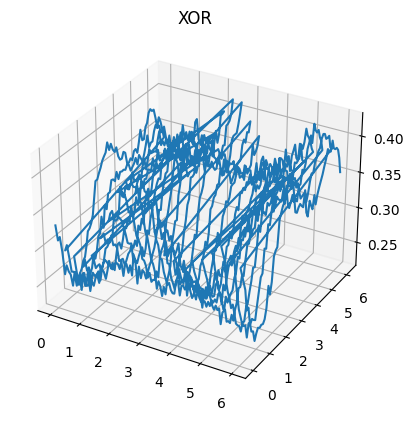

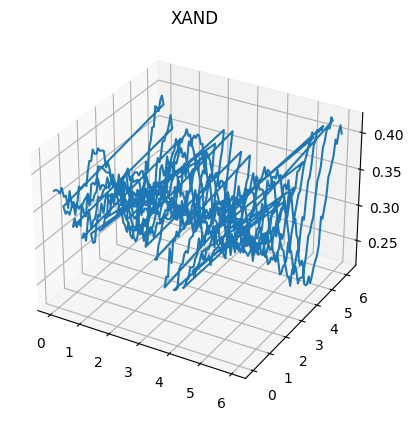

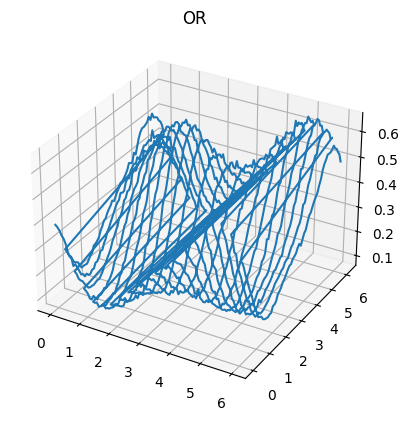

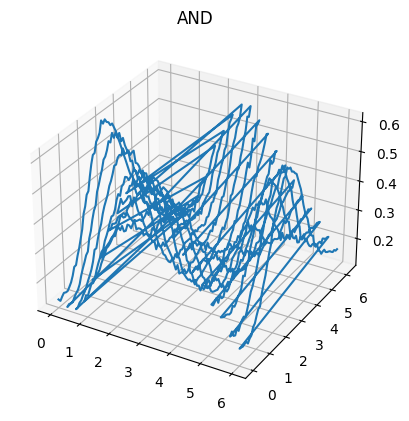

In [9]:
x_xor, y_xor, z_xor, min_xor = analyze_output_block(xor_output, 'XOR')
x_xand, y_xand, z_xand, min_xand = analyze_output_block(xand_output, 'XAND')
x_or, y_or, z_or, min_or = analyze_output_block(or_output, 'OR')
x_and, y_and, z_and, min_and = analyze_output_block(and_output, 'AND')

In [10]:
###### SPECIFIC TESTING
def specific_test(xdata, ydata, dataset, target_idx):
    test_weights = [xdata[target_idx], ydata[target_idx]]

    print(f'Starting qPercy test - thetas: {test_weights}')
    outs = []
    for batch in dataset:
        print(f'Testing -> {batch}')
        output, expected_out, error = qpercy_evaluation(batch, test_weights)
        outs.append(error)
    print(f'MSE: {np.sum(np.power(outs, 2)) / len(outs)}')

In [11]:
print('####### AND TEST #########')
specific_test(x_and, y_and, and_data, min_and)

####### AND TEST #########
Starting qPercy test - thetas: [0.3, 6.0]
Testing -> [0, 0, 0]
Result(backend_name='aer_simulator', backend_version='0.12.0', qobj_id='', job_id='0f29c796-3e6b-4335-b09c-afcd12b28b07', success=True, results=[ExperimentResult(shots=1000, success=True, meas_level=2, data=ExperimentResultData(counts={'0x1': 33, '0x0': 967}), header=QobjExperimentHeader(creg_sizes=[['c21169', 1]], global_phase=3.1200521828717367, memory_slots=1, metadata=None, n_qubits=1, name='circuit-105961', qreg_sizes=[['q127014', 1]]), status=DONE, seed_simulator=215773968, metadata={'parallel_state_update': 8, 'parallel_shots': 1, 'sample_measure_time': 0.0001955, 'noise': 'ideal', 'batched_shots_optimization': False, 'remapped_qubits': False, 'device': 'CPU', 'active_input_qubits': [0], 'measure_sampling': True, 'num_clbits': 1, 'input_qubit_map': [[0, 0]], 'num_qubits': 1, 'method': 'statevector', 'fusion': {'applied': False, 'max_fused_qubits': 5, 'threshold': 14, 'enabled': True}}, time

In [ ]:
theta1 = 5.8
theta2 = 1.6

batch = [0, 1, 1]
qout, eout, qerr = qpercy_evaluation()

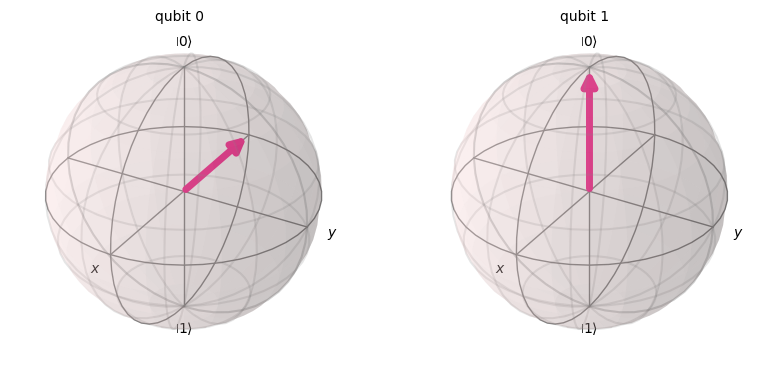

In [10]:
#### Rotation tests
from qiskit import QuantumCircuit
from qiskit.quantum_info import Statevector
from qiskit.visualization import plot_bloch_multivector
import numpy as np

qc = QuantumCircuit(2)
qc.ry(-np.pi / 2, 0)
# qc.rx(np.pi / 2, 0)

state = Statevector(qc)
plot_bloch_multivector(state)

In [7]:
inputs = [0, 0]

qreg = QuantumRegister(len(inputs))
creg = ClassicalRegister(1)
ckt = QuantumCircuit(qreg, creg)

ckt.h(qreg[0])
ckt.h(qreg[1])

ckt.cnot(qreg[0], qreg[1])
ckt.rz(np.pi / 2, qreg[0])
ckt.rz(np.pi / 2, qreg[1])

ckt.h(qreg[0])
ckt.h(qreg[1])

ckt.measure(qreg[1], creg[0])

ckt.draw()

┌───┐     ┌─────────┐┌───┐   
q3_0: ┤ H ├──■──┤ Rz(π/2) ├┤ H ├───
      ├───┤┌─┴─┐├─────────┤├───┤┌─┐
q3_1: ┤ H ├┤ X ├┤ Rz(π/2) ├┤ H ├┤M├
      └───┘└───┘└─────────┘└───┘└╥┘
c3: 1/═══════════════════════════╩═
                                 0

In [9]:
simulator = AerSimulator()
# Compile the circuit for the support instruction set (basis_gates)
# and topology (coupling_map) of the backend
compiled_circuit = transpile(ckt, simulator)

# Execute the circuit on the aer simulator
job = simulator.run(compiled_circuit, shots=1000)

# Grab results from the job
result = job.result()

# Returns counts
counts = result.get_counts(compiled_circuit)
print("\nTotal count for 00 and 11 are:", counts)


Total count for 00 and 11 are: {'1': 526, '0': 474}


In [ ]:
input_data = [
    [0, 0, 0],
    [0, 1, 1],
    [1, 0, 1],
    [1, 1, 1]
]

initial_weights = [
    np.pi/3,
    np.pi/4
]

n_epochs = 10

qneuron = QPercy(
    qubits=None, 
    quantum_circuit=None, 
    bias=1, 
    initial_weights=initial_weights, 
    learning_rate=0.3, 
    threshold=1)

for epoch in range(n_epochs):
    for batch_index in range(len(input_data)):
        binp = input_data[batch_index][:-1]
        bout = input_data[batch_index][-1]
        print(f"Epoch #{epoch} - Starting batch {batch_index} - weights = {initial_weights}")

        result = qneuron.process(binp)
        err = bout - result

        print(f"binp -> {binp}; bout -> {bout}; res -> {result}; err -> {err}")
        
        corrections = [ err * 0.2, err * 0.43 ]
        qneuron.correct_weights(corrections)

